In [1]:
import sys

In [2]:
sys.path.append('../')

In [3]:
import cPickle as pickle
import re
import glob
import os

import time

import theano
import theano.tensor as T
import numpy as np
import pandas as p
import lasagne as nn

from utils import hms, architecture_string, get_img_ids_from_iter

Using gpu device 0: GeForce GTX 960M (CNMeM is disabled, cuDNN 5105)
/home/ricky/anaconda2/lib/python2.7/site-packages/theano/sandbox/cuda/__init__.py:600: UserWarning: Your cuDNN version is more recent than the one Theano officially supports. If you see any problems, try updating Theano or downgrading cuDNN to version 5.
  warnings.warn(warn)
/home/ricky/anaconda2/lib/python2.7/site-packages/theano/tensor/signal/downsample.py:6: UserWarning: downsample module has been moved to the theano.tensor.signal.pool module.
  "downsample module has been moved to the theano.tensor.signal.pool module.")


In [4]:
import seaborn as sns

In [5]:
%pylab inline

rcParams['figure.figsize'] = 16, 6
# rcParams['text.color'] = 'red'
# rcParams['xtick.color'] = 'red'
# rcParams['ytick.color'] = 'red'

Populating the interactive namespace from numpy and matplotlib


In [6]:
np.set_printoptions(precision=3)
np.set_printoptions(suppress=True)

First we load the dump of the trained network.

In [7]:
dump_path = '../dumps/2017_02_17_123003.pkl'

In [8]:
model_data = pickle.load(open(dump_path, 'r'))

In [9]:
# Let's set the in and output layers to some local vars.
l_out = model_data['l_out']
l_ins = model_data['l_ins']

Some info about the architecture of the model:

In [10]:
model_arch = architecture_string(model_data['l_out'])

num_params = nn.layers.count_params(l_out)
model_arch += "\nNumber of parameters: %d.\n\n" % num_params

# Get some training/validation info.
selected_keys = ['acc_eval_train', 'acc_eval_valid',
                 'losses_eval_train', 'losses_eval_valid',
                 'metric_eval_train', 'metric_eval_valid',
                 'metric_cont_eval_train', 'metric_cont_eval_valid']
model_metrics = {key: model_data[key]
                 for key in selected_keys if key in model_data}

res_df = p.DataFrame(model_metrics)

model_arch += 'BEST/LAST KAPPA TRAIN: %.3f - %.3f.\n' % (
    res_df.metric_eval_train.max(),
    res_df.metric_eval_train.iloc[-1]
)
model_arch += 'BEST/LAST KAPPA VALID: %.3f - %.3f.\n' % (
    res_df.metric_eval_valid.max(),
    res_df.metric_eval_valid.iloc[-1]
)

model_arch += '\nBEST/LAST ACC TRAIN: %.2f - %.2f.\n' % (
    res_df.acc_eval_train.max() * 100,
    res_df.acc_eval_train.iloc[-1] * 100
)

model_arch += 'BEST/LAST ACC VALID: %.2f - %.2f.\n' % (
    res_df.acc_eval_valid.max() * 100,
    res_df.acc_eval_valid.iloc[-1] * 100
)

model_arch += '\nTOTAL TRAINING TIME: %s' % \
              hms(model_data['time_since_start'])

print model_arch

   0  InputLayer                   (64, 3, 512, 512)  
   1  Conv2DDNNLayer               (64, 32, 256, 256)  7 //2
   2  MaxPool2DDNNLayer            (64, 32, 127, 127)  3 //2
   3  Conv2DDNNLayer               (64, 32, 127, 127)  3 //1
   4  Conv2DDNNLayer               (64, 32, 127, 127)  3 //1
   5  MaxPool2DDNNLayer            (64, 32, 63, 63)  3 //2
   6  Conv2DDNNLayer               (64, 64, 63, 63)  3 //1
   7  Conv2DDNNLayer               (64, 64, 63, 63)  3 //1
   8  MaxPool2DDNNLayer            (64, 64, 31, 31)  3 //2
   9  Conv2DDNNLayer               (64, 128, 31, 31)  3 //1
  10  Conv2DDNNLayer               (64, 128, 31, 31)  3 //1
  11  Conv2DDNNLayer               (64, 128, 31, 31)  3 //1
  12  Conv2DDNNLayer               (64, 128, 31, 31)  3 //1
  13  MaxPool2DDNNLayer            (64, 128, 15, 15)  3 //2
  14  Conv2DDNNLayer               (64, 256, 15, 15)  3 //1
  15  Conv2DDNNLayer               (64, 256, 15, 15)  3 //1
  16  Conv2DDNNLayer               (64, 256, 

/home/ricky/anaconda2/lib/python2.7/site-packages/Lasagne-0.1.dev0-py2.7.egg/lasagne/layers/helper.py:69: UserWarning: get_all_layers() has been changed to return layers in topological order. The former implementation is still available as get_all_layers_old(), but will be removed before the first release of Lasagne. To ignore this warning, use `warnings.filterwarnings('ignore', '.*topo.*')`.
  warnings.warn("get_all_layers() has been changed to return layers in "


*Note:* very long training time (80 hours!) is because of the (slow) AWS GPU, You can get similar performance in (less than) 1 day with a GTX 980.

Some more kappa specific metrics:

In [11]:
train_conf_mat, hist_rater_a, \
        hist_rater_b, train_nom, \
        train_denom = model_data['metric_extra_eval_train'][-1]

In [12]:
valid_conf_mat, hist_rater_a, \
        hist_rater_b, valid_nom, \
        valid_denom = model_data['metric_extra_eval_valid'][-1]

In [13]:
# Normalised train confusion matrix (with argmax decoding).
print train_conf_mat / train_conf_mat.sum()

[[ 0.715  0.04   0.027  0.     0.   ]
 [ 0.014  0.016  0.008  0.     0.   ]
 [ 0.011  0.016  0.078  0.002  0.001]
 [ 0.     0.     0.03   0.02   0.001]
 [ 0.     0.     0.003  0.001  0.016]]


In [14]:
print valid_conf_mat

[[ 2474.   148.    97.     4.     3.]
 [   40.    56.    29.     0.     0.]
 [   53.    44.   297.    18.     9.]
 [    0.     0.   102.    58.    15.]
 [    2.     0.    11.     6.    48.]]


In [15]:
# Normalised validation confusion matrix (with argmax decoding).
print valid_conf_mat / valid_conf_mat.sum()

[[ 0.704  0.042  0.028  0.001  0.001]
 [ 0.011  0.016  0.008  0.     0.   ]
 [ 0.015  0.013  0.085  0.005  0.003]
 [ 0.     0.     0.029  0.017  0.004]
 [ 0.001  0.     0.003  0.002  0.014]]


Setting up some Theano / Lasagne things to get some predictions.

In [16]:
chunk_size = model_data['chunk_size'] * 2
batch_size = model_data['batch_size']

print "Batch size: %i." % batch_size
print "Chunk size: %i." % chunk_size

Batch size: 64.
Chunk size: 256.


In [17]:
output = nn.layers.get_output(l_out, deterministic=True)
input_ndims = [len(nn.layers.get_output_shape(l_in))
               for l_in in l_ins]
xs_shared = [nn.utils.shared_empty(dim=ndim)
             for ndim in input_ndims]
idx = T.lscalar('idx')

givens = {}
for l_in, x_shared in zip(l_ins, xs_shared):
    givens[l_in.input_var] = x_shared[idx * batch_size:(idx + 1) * batch_size]

compute_output = theano.function(
    [idx],
    output,
    givens=givens,
    on_unused_input='ignore'
)

In [18]:
# Do transformations per patient instead?
if 'paired_transfos' in model_data:
    paired_transfos = model_data['paired_transfos']
else:
    paired_transfos = False
    
print paired_transfos

True


We're going to test on some train images, so loading the training set labels.

In [19]:
train_labels = p.read_csv(os.path.join('../data/trainLabels.csv'))
#train_labels = p.read_csv(os.path.join('../data/test_solution.csv'))

In [20]:
print train_labels.head()

      image  level
0   10_left      0
1  10_right      0
2   13_left      0
3  13_right      0
4   15_left      1


In [21]:
# Get all patient ids.
patient_ids = sorted(set(get_img_ids_from_iter(train_labels.image)))

In [22]:
num_chunks = int(np.ceil((2 * len(patient_ids)) / float(chunk_size)))
num_chunks

138

In [54]:
# Where all the images are located: 
# it looks for [img_dir]/[patient_id]_[left or right].jpeg
#img_dir = '/media/ricky/Data/Data/train/'
img_dir = '/media/ricky/JKP_RKP2/data/train_large/'

Using the DataLoader to set up the parameters, you could replace it with something much simpler.

In [55]:
from generators import DataLoader

In [56]:
data_loader = DataLoader()
new_dataloader_params = model_data['data_loader_params']
new_dataloader_params.update({'images_test': patient_ids})
new_dataloader_params.update({'labels_test': train_labels.level.values})
new_dataloader_params.update({'prefix_train': img_dir})
data_loader.set_params(new_dataloader_params)

The next function is going to iterate over a test generator to get the outputs.

In [57]:
def do_pred(test_gen):
    outputs = []

    for e, (xs_chunk, chunk_shape, chunk_length) in enumerate(test_gen()):
        num_batches_chunk = int(np.ceil(chunk_length / float(batch_size)))

        print "Chunk %i/%i" % (e + 1, num_chunks)

        print "  load data onto GPU"
        for x_shared, x_chunk in zip(xs_shared, xs_chunk):
            x_shared.set_value(x_chunk)

        print "  compute output in batches"
        outputs_chunk = []
        for b in xrange(num_batches_chunk):
            out = compute_output(b)
            outputs_chunk.append(out)

        outputs_chunk = np.vstack(outputs_chunk)
        outputs_chunk = outputs_chunk[:chunk_length]

        outputs.append(outputs_chunk)

    return np.vstack(outputs), xs_chunk

We get the default "no transformation" parameters for the model.

In [58]:
no_transfo_params = model_data['data_loader_params']['no_transfo_params']

print no_transfo_params

{'extra_width_crop': True, 'rotation_before_resize': False, 'crop_height': False, 'resize_pad': False, 'keep_aspect_ratio': False}


And set up the test generator on the first 256 patients of the training set (512 images).

In [59]:
# The default gen with "no transfos".
test_gen = lambda: data_loader.create_fixed_gen(
    data_loader.images_test[:128*4],
    chunk_size=chunk_size,
    prefix_train=img_dir,
    prefix_test=img_dir,
    transfo_params=no_transfo_params,
    paired_transfos=paired_transfos,
)

Then we can get some predictions.

In [60]:
%%time
outputs_orig, chunk_orig = do_pred(test_gen)

Chunk 1/138
  load data onto GPU
  compute output in batches
Chunk 2/138
  load data onto GPU
  compute output in batches
Chunk 3/138
  load data onto GPU
  compute output in batches
Chunk 4/138
  load data onto GPU
  compute output in batches
CPU times: user 4min 34s, sys: 20.9 s, total: 4min 55s
Wall time: 5min 22s


Explore some of the predictions.

In [61]:
from metrics import continuous_kappa

In [62]:
outputs_labels = np.argmax(outputs_orig, axis=1)

kappa_eval = continuous_kappa(
                outputs_labels,
                train_labels.level.values[:outputs_labels.shape[0]],
            )

metric, conf_mat, \
    hist_rater_a, hist_rater_b, \
    nom, denom = kappa_eval
    
print 'Kappa %.4f' % metric, '\n'
print conf_mat, '\n'
print nom, '\n'
print nom / nom.sum(), nom.sum()

Kappa 0.8714 

[[727  37  28   0   0]
 [ 16  13   6   0   0]
 [ 13  12  93   6   0]
 [  0   0  22  21   1]
 [  0   0   3   1  25]] 

[[ 0.     2.312  7.     0.     0.   ]
 [ 1.     0.     0.375  0.     0.   ]
 [ 3.25   0.75   0.     0.375  0.   ]
 [ 0.     0.     1.375  0.     0.062]
 [ 0.     0.     0.75   0.062  0.   ]] 

[[ 0.     0.134  0.404  0.     0.   ]
 [ 0.058  0.     0.022  0.     0.   ]
 [ 0.188  0.043  0.     0.022  0.   ]
 [ 0.     0.     0.079  0.     0.004]
 [ 0.     0.     0.043  0.004  0.   ]] 17.3125


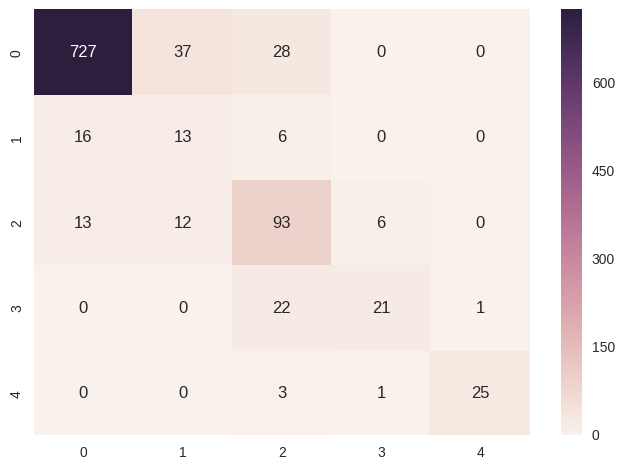

In [63]:
sns.set(font_scale=1)
sns.heatmap(conf_mat,annot=True,fmt='d')

Bit high of a kappa but this is because: 

1. There is a gap between the train and validation kappa.
2. This is a small sample.

Let's discriminate between train / validation.

In [64]:
train_imgs = set(data_loader.images_train_0)
valid_idx = [0  if img in train_imgs else 1 for img in data_loader.images_test]

In [65]:
df_preds = p.DataFrame([train_labels.image[:outputs_labels.shape[0]],
                        outputs_labels,
                        train_labels.level.values[:outputs_labels.shape[0]],
                       np.repeat(valid_idx, 2)[:outputs_labels.shape[0]]]).T
df_preds.columns = ['image', 'pred', 'true', 'valid']

The misclassifications:

In [66]:
df_preds[df_preds.pred != df_preds.true]

,image,pred,true,valid
4,15_left,0,1,0
5,15_right,0,2,0
9,17_right,0,1,0
23,30_right,0,2,0
28,36_left,0,1,0
30,40_left,1,2,0
31,40_right,1,0,0
43,51_right,1,0,0
78,78_left,0,2,0
79,78_right,0,2,0


In [67]:
df_preds.pred = df_preds.pred.astype('int')
df_preds.true = df_preds.true.astype('int')

In [68]:
df_preds.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1024 entries, 0 to 1023
Data columns (total 4 columns):
image    1024 non-null object
pred     1024 non-null int64
true     1024 non-null int64
valid    1024 non-null object
dtypes: int64(2), object(2)
memory usage: 32.1+ KB


In [69]:
from pandas_ml import ConfusionMatrix
cm = ConfusionMatrix(df_preds.true,df_preds.pred)

In [70]:
cm

Predicted    0   1    2   3   4  __all__
Actual                                  
0          727  16   13   0   0      756
1           37  13   12   0   0       62
2           28   6   93  22   3      152
3            0   0    6  21   1       28
4            0   0    0   1  25       26
__all__    792  35  124  44  29     1024

In [71]:
cm.print_stats()

Confusion Matrix:

Predicted    0   1    2   3   4  __all__
Actual                                  
0          727  16   13   0   0      756
1           37  13   12   0   0       62
2           28   6   93  22   3      152
3            0   0    6  21   1       28
4            0   0    0   1  25       26
__all__    792  35  124  44  29     1024


Overall Statistics:

Accuracy: 0.8583984375
95% CI: (0.83552676702908568, 0.87918639386265707)
No Information Rate: ToDo
P-Value [Acc > NIR]: 5.21549419815e-12
Kappa: 0.652125017572
Mcnemar's Test P-Value: ToDo


Class Statistics:

Classes                                        0          1          2  \
Population                                  1024       1024       1024   
P: Condition positive                        756         62        152   
N: Condition negative                        268        962        872   
Test outcome positive                        792         35        124   
Test outcome negative                        232 

Let's look at some sample activations:

In [42]:
diag_out = theano.function(
    [idx],
    nn.layers.get_output(nn.layers.get_all_layers(l_out), deterministic=True),
    givens=givens,
    on_unused_input="ignore"
)

In [43]:
diag_result = np.asarray(diag_out(0))

In [44]:
# The input images.
diag_result[0].shape

(64, 3, 512, 512)

In [45]:
def plot_rollaxis(im, figsize=(15, 15), 
                  zmuv_mean=data_loader.zmuv_mean, 
                  zmuv_std=data_loader.zmuv_std,
                 norm=True, ax=None):
    if not ax:
        fig, ax = plt.subplots(1, figsize=figsize)
        
    if norm:
        ax.imshow((zmuv_std[0] + 0.05) * np.rollaxis(im, 0, 3) + zmuv_mean[0])
    else:
        ax.imshow(np.rollaxis(im, 0, 3))
        
    return ax

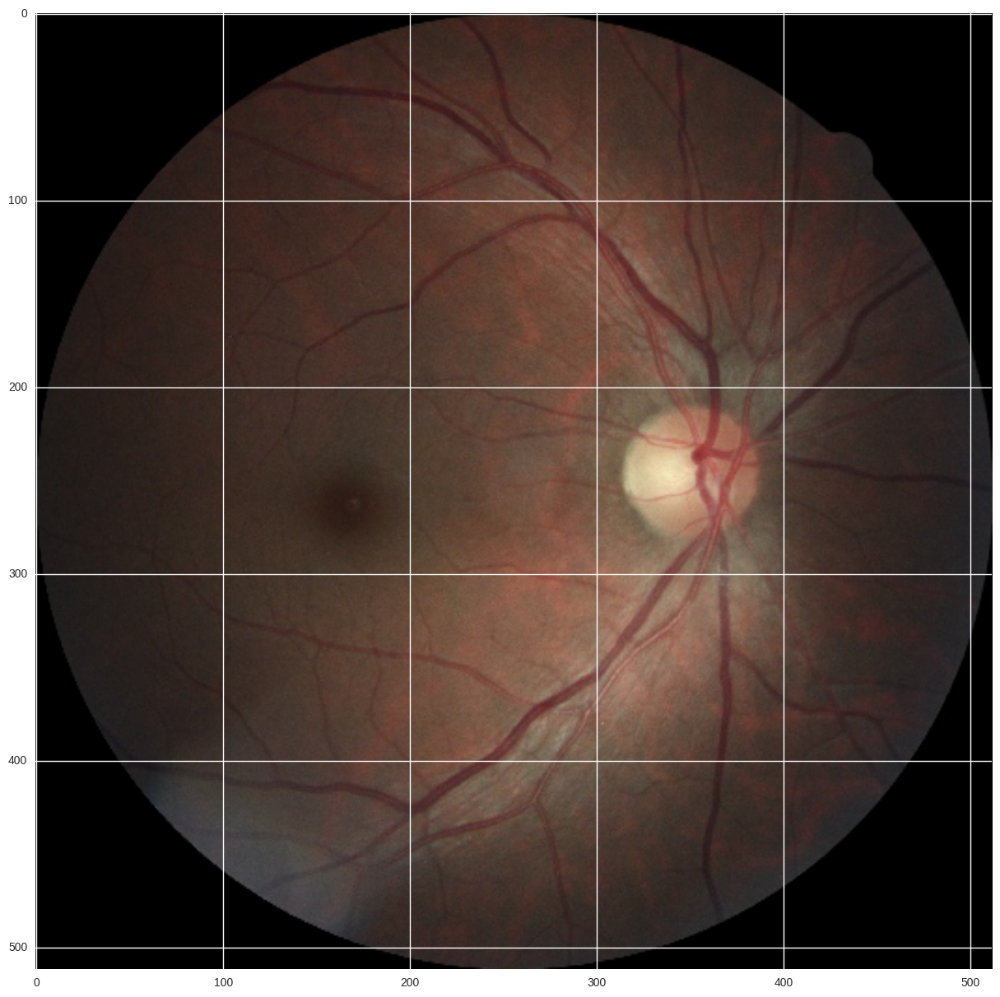

In [46]:
plot_rollaxis(diag_result[0][1])

Do keep in mind, we work in "chunks" and only the last "chunk" is still loaded on the GPU.

Since a chunk is 256 images, we can subset those predictions.

In [47]:
df_chunk = df_preds[-128*2:]
df_chunk['idx'] = np.repeat(range(128), 2)

print df_chunk

             image  pred  true valid  idx
53320   44129_left     0     0     0    0
53321  44129_right     0     0     0    0
53322   44130_left     0     3     0    1
53323  44130_right     0     3     0    1
53324   44131_left     1     0     0    2
53325  44131_right     1     0     0    2
53326   44132_left     2     3     0    3
53327  44132_right     2     2     0    3
53328   44135_left     0     0     0    4
53329  44135_right     0     0     0    4
53330   44136_left     0     0     0    5
53331  44136_right     0     0     0    5
53332   44137_left     0     0     0    6
53333  44137_right     0     0     0    6
53334   44138_left     0     0     0    7
53335  44138_right     0     0     0    7
53336   44139_left     3     2     0    8
53337  44139_right     3     2     0    8
53338   44140_left     0     0     0    9
53339  44140_right     0     0     0    9
53340   44142_left     1     0     0   10
53341  44142_right     1     0     0   10
53342   44143_left     0     0    

/home/ricky/anaconda2/lib/python2.7/site-packages/ipykernel/__main__.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  from ipykernel import kernelapp as app


In [48]:
# To print some output for a layer. (Hacky / quick.)
def print_output(layer_out, norm=False):
    fig, ax = plt.subplots(1, 2, sharey=True, figsize=(15, 200))

    for i, elem in enumerate(np.asarray(layer_out)[:2]):
        print elem.shape
        
        if norm:
            ax[i].imshow(np.concatenate(elem, axis=0), cmap=plt.cm.gray, 
                         vmin=np.asarray(layer_out).min(),
                         vmax=np.asarray(layer_out).max())
        else:        
            ax[i].imshow(np.concatenate(elem, axis=0), cmap=plt.cm.gray)

So, if we take index 8, we should see:

In [49]:
idx = 8

In [41]:
df_chunk[df_chunk.idx == idx]

,image,pred,true,valid,idx
272,320_left,2,1,0,8
273,320_right,2,2,0,8


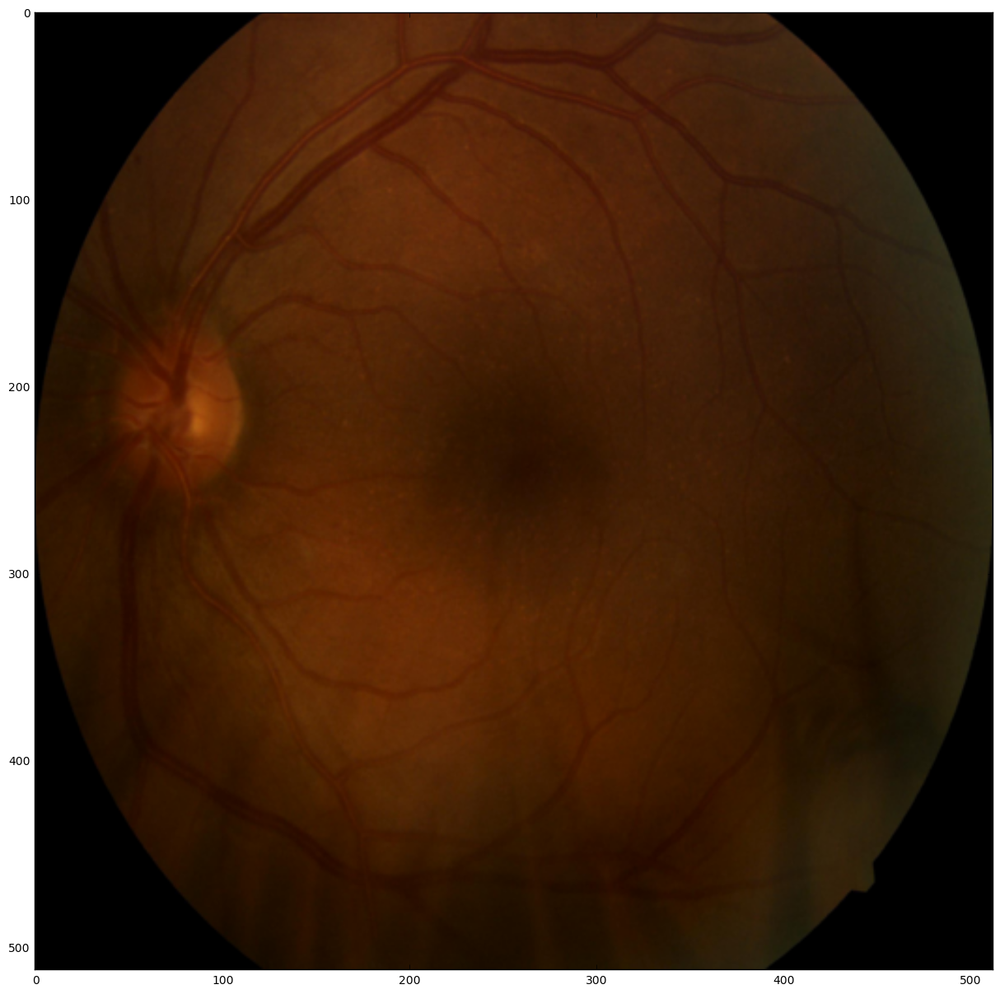

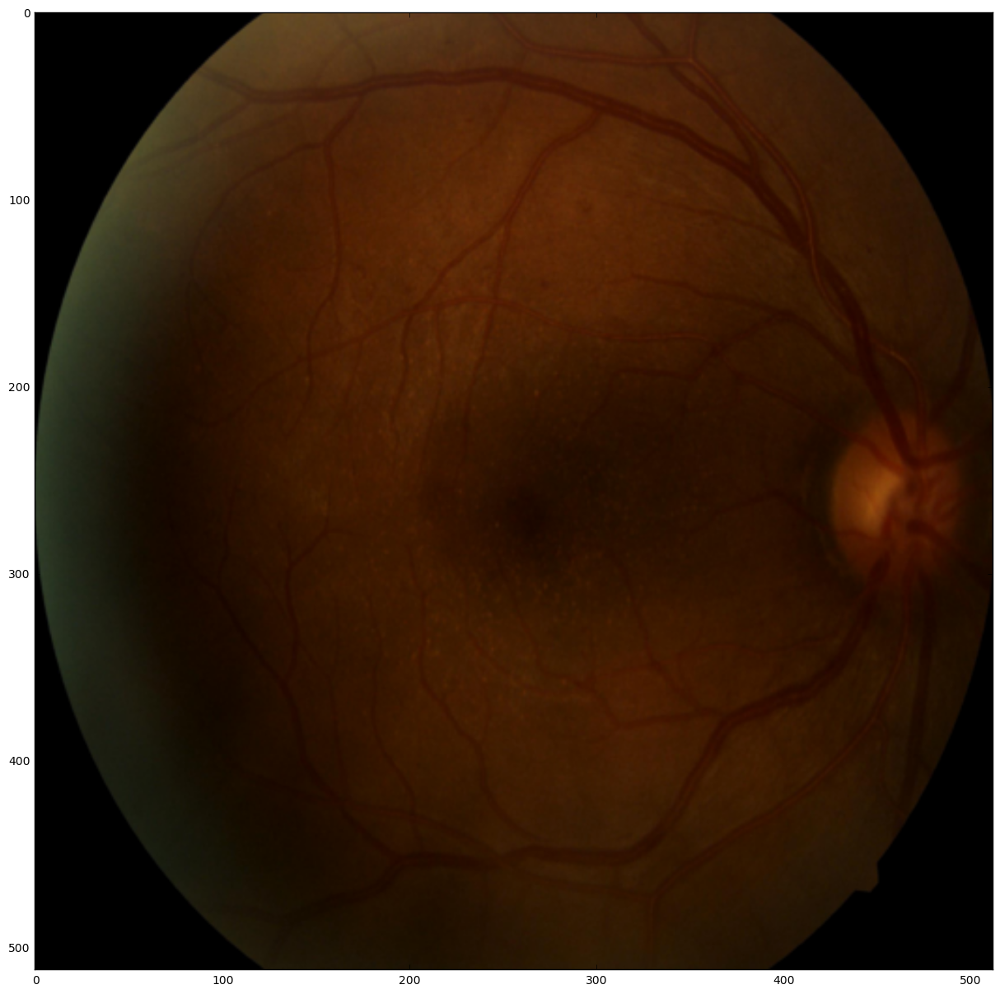

In [42]:
plot_rollaxis(diag_result[0][2*idx+0])  # Left.
plot_rollaxis(diag_result[0][2*idx+1])  # Right.

Let's see the output of one filter of the first layer for the left eye of that patient:

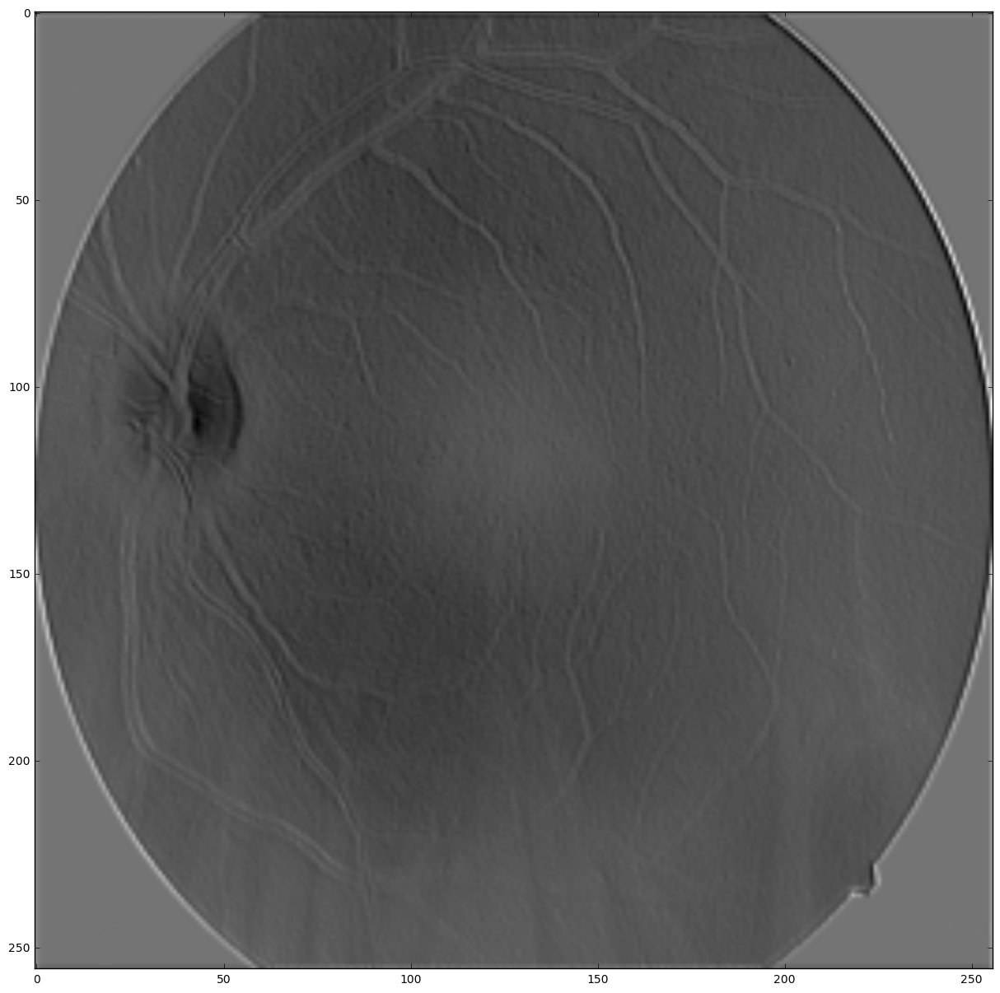

In [43]:
fig, ax = plt.subplots(figsize=(15, 15))

ax.imshow(diag_result[1][2*idx+0][24], cmap=plt.cm.gray)

If you do this for some images with microaneurysms, most of the time you will see them getting "detected".

You can then also follow this "detection" through the following layers.

To get the activations for both eyes for a certain layer, we can do:

(32, 127, 127)
(32, 127, 127)


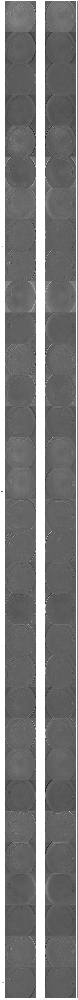

In [44]:
print_output(diag_result[4][2*idx:], norm=False)

Another one:

In [45]:
idx = 13

In [46]:
df_chunk[df_chunk.idx == idx]

,image,pred,true,valid,idx
282,328_left,3,2,0,13
283,328_right,3,3,0,13


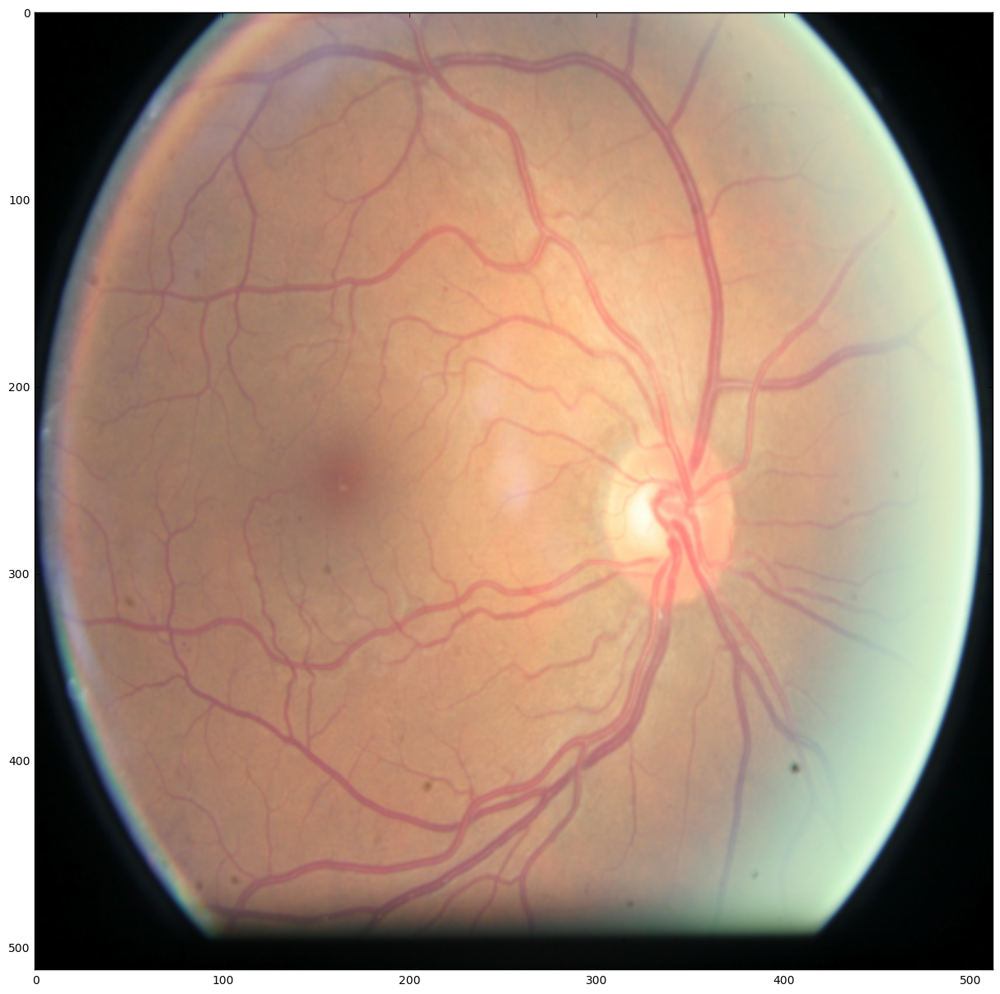

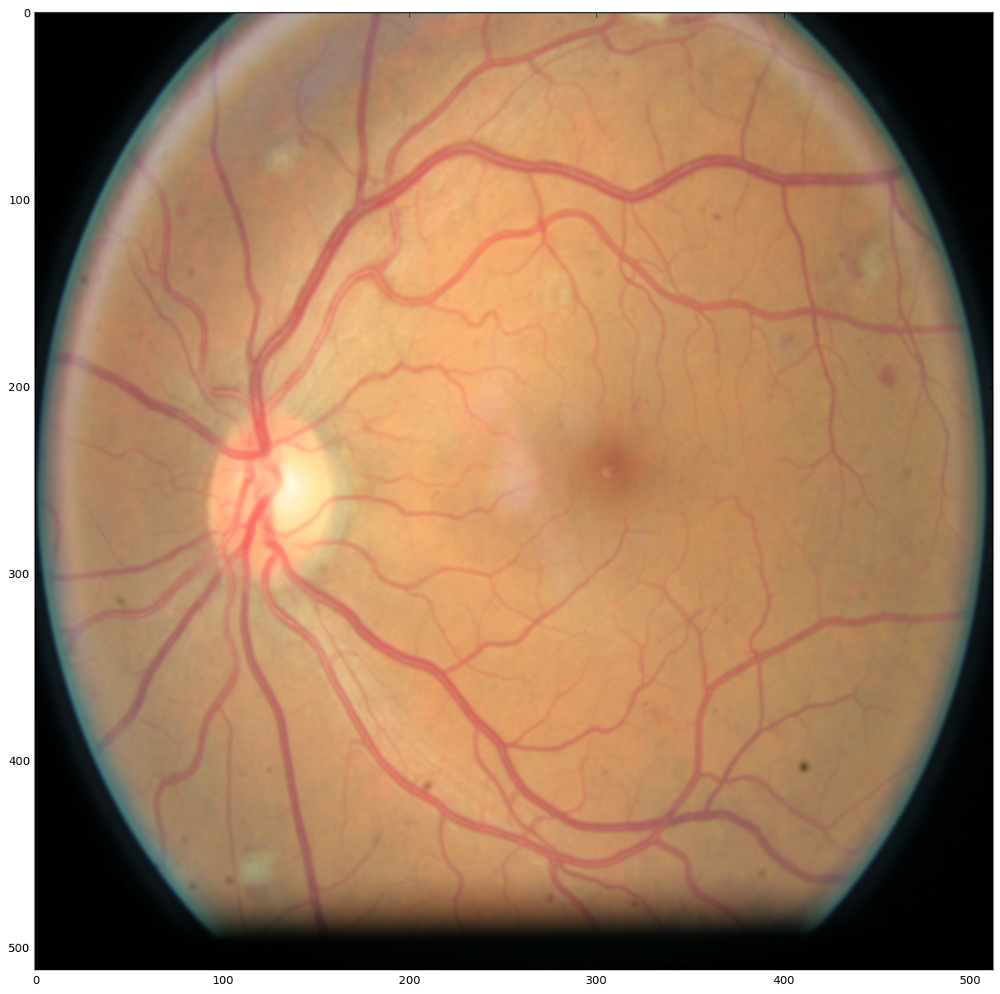

In [47]:
plot_rollaxis(diag_result[0][2*idx+0])  # Left.
plot_rollaxis(diag_result[0][2*idx+1])  # Right.

Notice **the camera artifacts**!

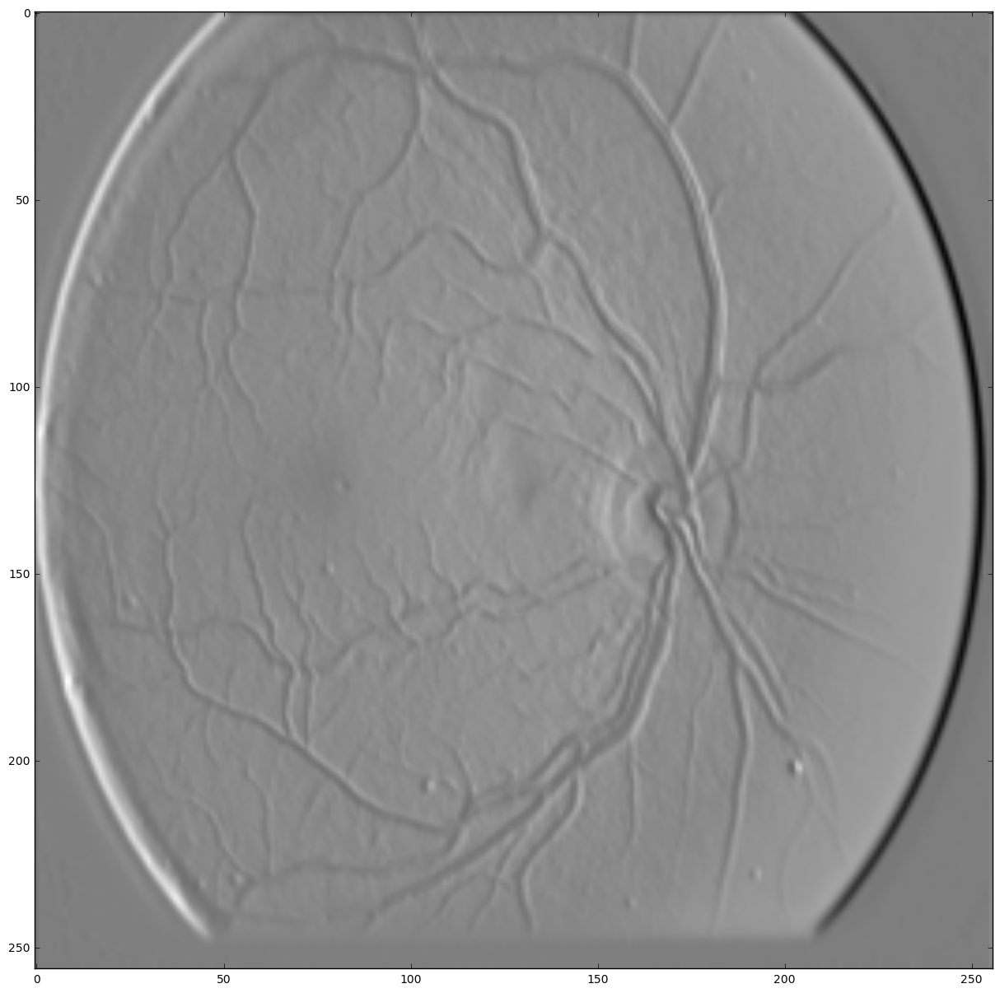

In [48]:
fig, ax = plt.subplots(figsize=(15, 15))

ax.imshow(diag_result[1][2*idx+0][10], cmap=plt.cm.gray)

(32, 127, 127)
(32, 127, 127)


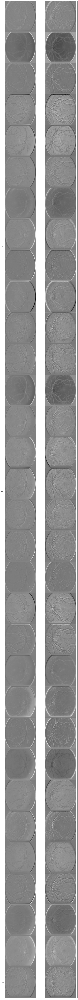

In [49]:
print_output(diag_result[3][2*idx:], norm=False)